In [6]:
import numpy as np
import pandas as pd

In [7]:
from gensim.models import KeyedVectors

In [8]:
embeddings_file = "data/news.cased.tokenized.word2vec.300d"

In [9]:
word2vec = KeyedVectors.load_word2vec_format(embeddings_file)

# Task 1 - classification

In [10]:
import gzip
import glob
import json
import os
import tokenize_uk

In [11]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

## Data

### Load data

In [12]:
def read_zfile(file):
    with gzip.open(file, 'rt') as f:
        return json.load(f.read())

In [13]:
def read_file(f):
    with gzip.open(f, 'rt', encoding='utf-8') as inf:
        j = json.load(inf)
        text = j[0]['CallZText']
        return text, j[0]['CallZType']
#         if is_uk_language(text):
#             return text, j[0]['CallZType']

In [14]:
def read_all_zip_files_from_dir(dir_path):
    data = []
    for f in glob.glob(f"{dir_path}/*/*"):
        data.append(read_file(f))
    return data

In [15]:
!ls data

1551.gov.ua  news.cased.tokenized.word2vec.300d


In [16]:
data = read_all_zip_files_from_dir("data/1551.gov.ua/raw")

In [17]:
data = np.array(data)

In [18]:
len(data)

127329

##### filter emty data

In [20]:
data = np.array([item for item in data if len(item[0]) > 0])

In [21]:
len(data)

126789

### Analyze data

In [22]:
from plotly.offline import iplot
import cufflinks
cufflinks.go_offline()
cufflinks.set_config_file(world_readable=True, theme='pearl')

In [26]:
X_text = data[:, 0]
y = data[:, 1]

In [27]:
labels = np.unique(y)
print(f"There are {len(labels)} classes.")

There are 918 classes.


In [28]:
df = pd.DataFrame({
    'text' : X_text,
    'label' : y
})

In [29]:
df.head()

,text,label
0,Квартира 2х комнатная нет отопления в кухне ме...,Відсутність опалення по стояку
1,Щодня дорогою на роботу та з роботи доволиться...,Робота світлофора
2,"Приберіть сміття біля будинку №4, а саме за б...",Прибирання та санітарний стан територій
3,прошу повідомити чому відсутнє по над тиждень ...,Відсутність освітлення у під’їзді за відсутнос...
4,"Немає освітлення над входом до 2, 3 та 4 під”ї...",Освітлення в приміщенні й при вході в нього


In [30]:
df['label'].iplot(
    kind='hist',
    bins=5,
    xTitle='rating',
    linecolor='black',
    yTitle='count',
    title='Label count distribution')

In [93]:
def calc_label_counter(y):
    label_counter_dict = dict()
    for yi in y:
        if yi not in label_counter_dict:
            label_counter_dict[yi] = 1
        else:
            label_counter_dict[yi] += 1
    return sorted(label_counter_dict.items(), key=lambda item: item[1], reverse=True)

In [31]:
label_counter = calc_label_counter(y)

In [33]:
one_label = [item for item in label_counter if item[1] < 2]

In [34]:
len(one_label)

124

In [35]:
one_label

[('Стан поштових скриньок центрального відділення зв’язку', 1),
 ('Зміна режиму роботи трамваїв.', 1),
 ('Вирішення суперечок про місце проживання дітей', 1),
 ('Режим роботи аптечного закладу', 1),
 ('Закриття та перепрофілювання об’єктів з надання побутових послуг населенню',
  1),
 ('Безоплатне або пільгове забезпечення автомобілем', 1),
 ('Невизначеність зон для катання на човнах,занять водними видами спорту', 1),
 ('Питання, що відносяться до стратегії розвитку м.Києва до 2025 року:', 1),
 ('Незадовільна організація роботи та якість обслуговування (1557)', 1),
 ('Працевлаштування в сфері благоустрою міста', 1),
 ('Відновлення трамвайних маршрутів', 1),
 ('Надання дозволів на використання повітряного простору в межах', 1),
 ('Питання стосовно нарахування боргу за споживання ХВП', 1),
 ('Визначення статусу громадян, які потерпіли від катастрофи на ЧАЕС', 1),
 ('Відсутність на станціях покажчиків руху, об’яв про час відкриття  та закриття',
  1),
 ('Створення та діяльність садових то

In [36]:
max_ten_label = [item for item in label_counter if item[1] <= 10]

In [37]:
len(max_ten_label)

437

In [38]:
label_counter[0][1]

13253

In [39]:
len(label_counter_dict)

918

In [40]:
more_100_label_items = [item for item in label_counter if item[1] >= 100]

In [41]:
more_100_labels = np.array(more_100_label_items)[:,0]

In [42]:
len(more_100_labels)

187

Let's consider only data where we have more than 100 different text for each label.

In [43]:
more_100_data = np.array([item for item in data if item[1] in more_100_labels])

In [44]:
len(more_100_data)

114222

In [107]:
X_text = more_100_data[:,0]
y = more_100_data[:,1]

### Baseline

In [46]:
from sklearn.neighbors import KNeighborsClassifier

In [47]:
def vectorize(text):
    words = tokenize_uk.tokenize_words(text)
    v = np.array(300 * [0.0])
    for w in words:
        if w in word2vec:
            v += word2vec[w]
    v /= len(words)
    return v

In [48]:
X = [vectorize(x) for x in X_text]

In [49]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=42)

In [50]:
len(np.unique(y_test))

187

In [51]:
len(np.unique(y_train))

187

In [52]:
knn_model = KNeighborsClassifier(n_neighbors=5, metric='cosine')

In [53]:
knn_model.fit(X_train, y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='cosine',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')

In [54]:
y_pred = knn_model.predict(X_test)

In [55]:
print(classification_report(y_test, y_pred))

                                                                                  precision    recall  f1-score   support

                                                                     Інші Подяки       0.20      0.20      0.20       157
                                              Інші технічні недоліки стану ліфту       0.11      0.35      0.17       472
                Аварійний, травмонебезпечний стан утримання об’єктів благоустрою       0.05      0.09      0.06       143
                                          Бажаючі отримати ”Картки киянина (КК)”       0.20      0.22      0.21        36
                              Будівництво /дооблаштування спортивних майданчиків       0.05      0.08      0.06        51
                                                                 Будівництво АЗС       0.10      0.14      0.12        35
                                                        Будівництво в нічний час       0.09      0.11      0.10        47
                       

##### Let's define baseline F1-score (macro avg): 0.17.

## Improve baseline

In [79]:
import langdetect
from typing import Dict
from gensim.models.keyedvectors import Word2VecKeyedVectors
from fuzzyset import FuzzySet

### Pre-process data

In [75]:
def is_uk_language(text):
    try:
        if langdetect.detect(text) == 'uk':
            return True
    except:
        return False

    return False

#### filter non-ukrainian language

In [76]:
def filter_non_ukrainian_text(X, y):
    assert len(X) == len(y)
    filtered_X, filtered_y = [], []
    for i in range(0, len(X)):
        if is_uk_language(X[i]):
            filtered_X.append(X[i])
            filtered_y.append(y[i])
            
    return filtered_X, filtered_y

In [109]:
X_uk_text, y_uk = filter_non_ukrainian_text(X_text, y)

In [112]:
is_uk_language(X_uk_text[1])

True

In [113]:
len(X_uk_text)

61756

In [114]:
label_counter = calc_label_counter(y_uk)

In [115]:
more_100_labels = [item[0] for item in label_counter if item[1] >= 100]

In [116]:
len(more_100_labels)

125

**Let's consider only lables which has more than 100 examples of text**

In [117]:
def filter_by_labels(X, y, labels):
    assert len(X) == len(y)
    filtered_X, filtered_y = [], []
    for i in range(0, len(X)):
        if y[i] in labels:
            filtered_X.append(X[i])
            filtered_y.append(y[i])
            
    return filtered_X, filtered_y 

In [118]:
X_text, y = filter_by_labels(X_uk_text, y_uk, more_100_labels)

In [119]:
len(X_text)

57234

#### Fix incorrect written words

In [137]:
class WordFixer:

    def __init__(self, word2vec: Word2VecKeyedVectors):
        self.__word2vec = word2vec
        self.__fixed_word_dict: Dict[str, str] = dict()

        self.__approximate_matcher = FuzzySet(word2vec.vocab)

    def is_word_correct(self, word: str):
        if word in self.__word2vec:
            return True
        return False

    def fix(self, word: str):

        if word in self.__fixed_word_dict:
            return self.__fixed_word_dict[word]

        candidate = self.__approximate_matcher.get(word)
        if candidate is not None and len(candidate) > 0:
            fixed_word = candidate[0][1]
            self.__fixed_word_dict[word] = fixed_word
            return fixed_word

        return None
    
    def count_fixed_words(self):
        return len(self.__fixed_word_dict)


In [138]:
word_fixer = WordFixer(word2vec)

In [139]:
word_fixer.fix('неправилно')

'неправильно'

In [140]:
word_fixer.fix('даеко')

'далеко'

In [141]:
word_fixer.count_fixed_words()

2

#### ignore punctuationa and other pos tags

In [124]:
import pymorphy2
morph = pymorphy2.MorphAnalyzer(lang='uk')

In [134]:
def is_suitable_token(token, stop_words = []):
    token = token.lower()
    if token.isdigit():
        return False
    
    if token in stop_words:
        return False

    parse = morph.parse(token)[0]
    
    if parse.normal_form in stop_words:
        return False
    
    if parse.tag.POS in {'NUMR', 'NPRO', 'PREP', 'CONJ', 'PRCL'}:
        return False
    
    
    if 'UNKN' in parse.tag:
        return False
    
    if 'NUMB' in parse.tag:
        return False
    
    if 'PNCT' in parse.tag:
        return False

    
    return True


In [135]:
is_suitable_token('куди')

False

In [136]:
is_suitable_token('вода')

True

Let's vectorize text using pos filters and fix incorrect written words

In [149]:
def vectorize_with_filters(text):
    words = tokenize_uk.tokenize_words(text)
    v = np.array(300 * [0.0])
    for w in words:
        word = None
        if w in word2vec:
            word = w
        else:
            word = word_fixer.fix(w)
        
        if word:
            if is_suitable_token(word):
                v += word2vec[word]
    v /= len(words)
    return v 

In [150]:
X = [vectorize_with_filters(x) for x in X_text]

In [151]:
len(X)

57234

In [159]:
#87216

In [153]:
print(f"In general there are fixed {word_fixer.count_fixed_words()} incorrected written words.")

In general there are fixed 87216 incorrected written words.


In [154]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=42)

In [155]:
knn_model.fit(X_train, y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='cosine',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')

In [157]:
y_test_pred = knn_model.predict(X_test)

In [158]:
print(classification_report(y_test, y_test_pred))

                                                                                  precision    recall  f1-score   support

                                                                     Інші Подяки       0.40      0.33      0.36        81
                                              Інші технічні недоліки стану ліфту       0.20      0.43      0.28       197
                Аварійний, травмонебезпечний стан утримання об’єктів благоустрою       0.10      0.18      0.13        78
                                    Будівництво та реконструкція об’єктів освіти       0.45      0.61      0.52        38
                                  Будівництво/дооблаштування дитячого майданчику       0.39      0.75      0.51       198
                                Видалення аварійних, пошкоджених хворобами дерев       0.27      0.35      0.31       108
                                                      Вилов безпритульних тварин       0.51      0.72      0.60        36
                       

As we can see filter non-ukraninan language and fixing incorrectly written words improved classification compare to baseline, F1:score (macro avg): 0.31 > 0.17.

# Task 2 - visualization

In [151]:
from sklearn.manifold import TSNE
import seaborn as sns
import matplotlib.patheffects as PathEffects
import matplotlib.pyplot as plt


In [145]:
digits_proj =  TSNE(perplexity=3, n_components=2, init='pca', n_iter=3500, random_state=32, metric='cosine').fit_transform(X_test)

In [153]:
def scatter(x, colors, n):
    # We choose a color palette with seaborn.
    palette = np.array(sns.color_palette("hls", n))

    # We create a scatter plot.
    f = plt.figure(figsize=(8, 8))
    ax = plt.subplot(aspect='equal')
    sc = ax.scatter(x[:,0], x[:,1], lw=0, s=40,
                    c=palette[colors.astype(np.int)])
    plt.xlim(-25, 25)
    plt.ylim(-25, 25)
    ax.axis('off')
    ax.axis('tight')

    # We add the labels for each digit.
    txts = []
    for i in range(n):
        # Position of each label.
        xtext, ytext = np.median(x[colors == i, :], axis=0)
        txt = ax.text(xtext, ytext, str(i), fontsize=24)
        txt.set_path_effects([
            PathEffects.Stroke(linewidth=5, foreground="w"),
            PathEffects.Normal()])
        txts.append(txt)

    return f, ax, sc, txts

In [158]:
colors = []
d = dict()
count = 0
for yi in y_pred:
    if yi not in d:
        d[yi] = count
        count += 1
    colors.append(d[yi])

(<Figure size 576x576 with 1 Axes>,
 [Text(27.663265, -78.42833, '0'),
  Text(-57.46218, 55.14019, '1'),
  Text(-40.078068, 72.59791, '2'),
  Text(-97.77702, 48.27649, '3'),
  Text(41.63274, -52.352776, '4'),
  Text(-26.470226, 97.80693, '5'),
  Text(-60.43373, -26.249443, '6'),
  Text(7.0440197, 26.645138, '7'),
  Text(2.2367055, -51.436375, '8'),
  Text(76.74361, 30.577374, '9'),
  Text(35.47799, -37.96308, '10'),
  Text(19.323496, -51.864967, '11'),
  Text(57.981953, -21.213787, '12'),
  Text(-62.722622, 109.51711, '13'),
  Text(-7.5849237, -63.32628, '14'),
  Text(0.32710052, 9.940405, '15'),
  Text(-66.01036, 52.2233, '16'),
  Text(-20.142086, 7.373833, '17'),
  Text(-31.791166, 47.413063, '18'),
  Text(-18.802767, 33.206047, '19'),
  Text(-15.971173, 20.975388, '20'),
  Text(-119.26295, 78.72502, '21'),
  Text(40.76087, 17.417841, '22'),
  Text(-0.83575296, 31.394598, '23'),
  Text(41.985497, -9.899295, '24'),
  Text(-49.20762, 55.11838, '25'),
  Text(-7.4041567, -2.8714812, '26'

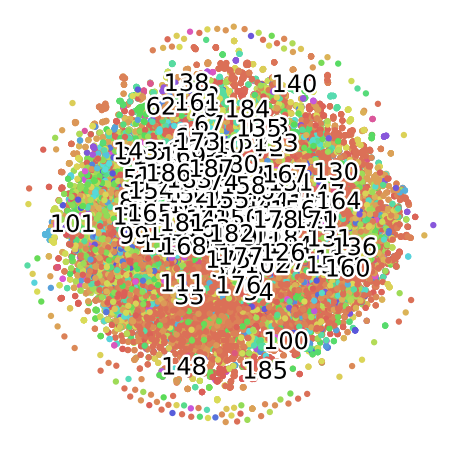

In [159]:
scatter(digits_proj, np.array(colors), len(np.unique(colors)))

In [150]:
len(np.unique(colors))

188